In [ ]:
from google.colab import files
files.upload()

In [ ]:
!pip install -q kaggle

In [ ]:
!mkdir -p ~/.kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!mkdir cctv

In [ ]:
!cd cctv

In [ ]:
!kaggle datasets download -d toluwaniaremu/smartcity-cctv-violence-detection-dataset-scvd

 99% 952M/960M [00:11<00:00, 79.2MB/s]
100% 960M/960M [00:11<00:00, 84.1MB/s]


In [ ]:
!unzip /content/smartcity-cctv-violence-detection-dataset-scvd.zip

Archive:  /content/smartcity-cctv-violence-detection-dataset-scvd.zip
  inflating: SCVD/videos/Non-Violence Videos/nv1.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv10.mp4  
  inflating: SCVD/videos/Non-Violence Videos/nv100.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv101.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv102.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv103.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv104.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv105.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv106.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv107.mov  
  inflating: SCVD/videos/Non-Violence Videos/nv108.mp4  
  inflating: SCVD/videos/Non-Violence Videos/nv109.mp4  
  inflating: SCVD/videos/Non-Violence Videos/nv11.mp4  
  inflating: SCVD/videos/Non-Violence Videos/nv110.mp4  
  inflating: SCVD/videos/Non-Violence Videos/nv111.mp4  
  inflating: SCVD/videos/Non-Violence Videos/nv112.mp4  
  inflating: SCVD/vide

In [70]:
import os
import shutil
import cv2
import math
import random
import numpy as np
import datetime as dt
import tensorflow 
import keras
from collections import deque
import matplotlib.pyplot as plt
plt.style.use("seaborn")

%matplotlib inline
 
from sklearn.model_selection import train_test_split
 
from keras.layers import *
from keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from keras.applications import MobileNet
from keras import regularizers
from keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model

<ipython-input-70-53ee513b105a>:12: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


In [52]:
from IPython.display import HTML
from base64 import b64encode

# To Show a Video in Notebook
def Play_Video(filepath):
    html = ''
    video = open(filepath,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=640 muted controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
    return HTML(html)

In [53]:
# Classes Directories
NonViolnceVideos_Dir = "/content/SCVD/videos/Non-Violence Videos"
ViolnceVideos_Dir = "/content/SCVD/videos/Weapon Violence"
Weapon_violence_Dir = "/content/SCVD/videos/Weapon Violence"

# Retrieve the list of all the video files present in the Class Directory.
NonViolence_files_names_list = os.listdir(NonViolnceVideos_Dir)
Violence_files_names_list = os.listdir(ViolnceVideos_Dir)
Weapon_files_names_list = os.listdir(Weapon_violence_Dir)

# Randomly select a video file from the Classes Directory.
Random_NonViolence_Video = random.choice(NonViolence_files_names_list)
Random_Violence_Video = random.choice(Violence_files_names_list)
Random_Weapon_Video = random.choice(Weapon_files_names_list)

In [54]:
Play_Video(f"{NonViolnceVideos_Dir}/{Random_NonViolence_Video}")

In [55]:
Play_Video(f"{ViolnceVideos_Dir}/{Random_Violence_Video}")

In [56]:
Play_Video(f"{Weapon_violence_Dir}/{Random_Weapon_Video}")

In [57]:
# Specify the height and width to which each video frame will be resized in our dataset.
IMAGE_HEIGHT , IMAGE_WIDTH = 64, 64
 
# Specify the number of frames of a video that will be fed to the model as one sequence.
SEQUENCE_LENGTH = 16
 

DATASET_DIR = "/content/SCVD/videos"
 
CLASSES_LIST = ["Non-Violence Videos","violence video cleaned", "Weapon Violence"]

In [58]:
def frames_extraction(video_path):
 
    frames_list = []
    
    # Read the Video File
    video_reader = cv2.VideoCapture(video_path)
 
    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
 
    # Calculate the the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)
 
    # Iterate through the Video Frames.
    for frame_counter in range(SEQUENCE_LENGTH):
 
        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
 
        # Reading the frame from the video. 
        success, frame = video_reader.read() 
 
        if not success:
            break
 
        # Resize the Frame to fixed height and width.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame
        normalized_frame = resized_frame / 255
        
        # Append the normalized frame into the frames list
        frames_list.append(normalized_frame)
    
 
    video_reader.release()
 
    return frames_list

In [59]:
def create_dataset():
 
    features = []
    labels = []
    video_files_paths = []
    
    # Iterating through all the classes.
    for class_index, class_name in enumerate(CLASSES_LIST):
        
        print(f'Extracting Data of Class: {class_name}')
        
        # Get the list of video files present in the specific class name directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
        
        # Iterate through all the files present in the files list.
        for file_name in files_list:
            
            # Get the complete video path.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)
 
            # Extract the frames of the video file.
            frames = frames_extraction(video_file_path)
 
            # Check if the extracted frames are equal to the SEQUENCE_LENGTH specified.
            # So ignore the vides having frames less than the SEQUENCE_LENGTH.
            if len(frames) == SEQUENCE_LENGTH:
 
                # Append the data to their repective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)
 
    features = np.asarray(features)
    labels = np.array(labels)  

    return features, labels, video_files_paths

In [60]:
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: Non-Violence Videos
Extracting Data of Class: violence video cleaned
Extracting Data of Class: Weapon Violence


In [61]:
np.save("features.npy",features)
np.save("labels.npy",labels)
np.save("video_files_paths.npy",video_files_paths)

In [69]:
features, labels, video_files_paths = np.load("features.npy") , np.load("labels.npy") ,  np.load("video_files_paths.npy")

In [63]:
one_hot_encoded_labels = to_categorical(labels)

In [64]:
# Split the Data into Train ( 90% ) and Test Set ( 10% ).
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.1,
                                                                            shuffle = True, random_state = 42)

In [65]:
print(features_train.shape,labels_train.shape )
print(features_test.shape, labels_test.shape)

(327, 16, 64, 64, 3) (327, 3)
(37, 16, 64, 64, 3) (37, 3)


In [66]:
from keras.applications.mobilenet_v2 import MobileNetV2

mobilenet = MobileNetV2( include_top=False , weights="imagenet")

#Fine-Tuning to make the last 40 layer trainable
mobilenet.trainable=True

for layer in mobilenet.layers[:-40]:
  layer.trainable=False

#mobilenet.summary()

In [93]:
def create_model():
 
    model = Sequential()

    ########################################################################################################################
    
    #Specifying Input to match features shape
    model.add(Input(shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    
    # Passing mobilenet in the TimeDistributed layer to handle the sequence
    model.add(TimeDistributed(mobilenet))
    
    model.add(Dropout(0.25))
                                    
    model.add(TimeDistributed(Flatten()))

    
    lstm_fw = LSTM(units=32)
    lstm_bw = LSTM(units=32, go_backwards = True)  

    model.add(Bidirectional(lstm_fw, backward_layer = lstm_bw))
    
    model.add(Dropout(0.25))

    model.add(Dense(256,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(64,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(32,activation='relu'))
    model.add(Dropout(0.25))
    
    
    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))
 
    ########################################################################################################################
 
    model.summary()
    
    return model

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_2 (TimeDis  (None, 16, 2, 2, 1280)   2257984   
 tributed)                                                       
                                                                 
 dropout_4 (Dropout)         (None, 16, 2, 2, 1280)    0         
                                                                 
 time_distributed_3 (TimeDis  (None, 16, 5120)         0         
 tributed)                                                       
                                                                 
 bidirectional_1 (Bidirectio  (None, 64)               1319168   
 nal)                                                            
                                                                 
 dropout_5 (Dropout)         (None, 64)                0         
                                                      

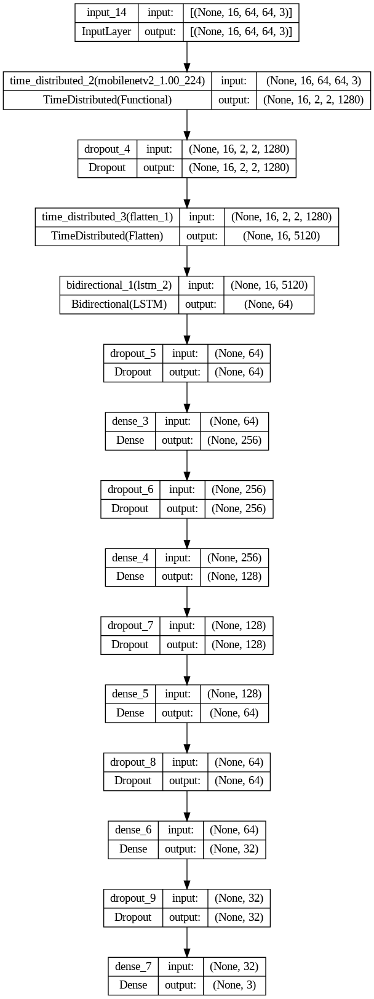

In [94]:
# Constructing the Model
MoBiLSTM_model = create_model()

# Plot the structure of the contructed LRCN model.
plot_model(MoBiLSTM_model, to_file = 'MobBiLSTM_model_structure_plot.png', show_shapes = True, show_layer_names = True)

In [95]:
# Create Early Stopping Callback to monitor the accuracy
early_stopping_callback = EarlyStopping(monitor = 'val_accuracy', patience = 10, restore_best_weights = True)

# Create ReduceLROnPlateau Callback to reduce overfitting by decreasing learning
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                  factor=0.5,
                                                  patience=5,
                                                  min_lr=0.00005,
                                                  verbose=1)
 
# Compiling the model 
MoBiLSTM_model.compile(loss = 'categorical_crossentropy', optimizer = 'sgd', metrics = ["accuracy"])
 
# Fitting the model 
MobBiLSTM_model_history = MoBiLSTM_model.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 4 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback,reduce_lr])

Epoch 1/50
66/66 [==============================] - 71s 920ms/step - loss: 1.1176 - accuracy: 0.3563 - val_loss: 1.0948 - val_accuracy: 0.3636 - lr: 0.0100
Epoch 2/50
66/66 [==============================] - 53s 805ms/step - loss: 1.1110 - accuracy: 0.3333 - val_loss: 1.0951 - val_accuracy: 0.3636 - lr: 0.0100
Epoch 3/50
66/66 [==============================] - 54s 814ms/step - loss: 1.0965 - accuracy: 0.3831 - val_loss: 1.0940 - val_accuracy: 0.3636 - lr: 0.0100
Epoch 4/50
66/66 [==============================] - 55s 821ms/step - loss: 1.1047 - accuracy: 0.3372 - val_loss: 1.0936 - val_accuracy: 0.3788 - lr: 0.0100
Epoch 5/50
66/66 [==============================] - 56s 846ms/step - loss: 1.0977 - accuracy: 0.3525 - val_loss: 1.0925 - val_accuracy: 0.3788 - lr: 0.0100
Epoch 6/50
66/66 [==============================] - 56s 849ms/step - loss: 1.0907 - accuracy: 0.3831 - val_loss: 1.0851 - val_accuracy: 0.4697 - lr: 0.0100
Epoch 7/50
66/66 [==============================] - 55s 828ms/st

In [96]:
model_evaluation_history = MoBiLSTM_model.evaluate(features_test, labels_test)

2/2 [==============================] - 3s 378ms/step - loss: 1.0624 - accuracy: 0.4324


In [74]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
    
    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]
    
    # Get the Epochs Count
    epochs = range(len(metric_value_1))
 
    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'orange', label = metric_name_2)
 
    plt.title(str(plot_name))
 
    plt.legend()

In [76]:
labels_predict = MoBiLSTM_model.predict(features_test)

2/2 [==============================] - 4s 213ms/step


In [77]:
#Decoding the data to use in Metrics
labels_predict = np.argmax(labels_predict , axis=1)
labels_test_normal = np.argmax(labels_test , axis=1)

In [78]:
labels_test_normal.shape , labels_predict.shape

((37,), (37,))

In [79]:
from sklearn.metrics import accuracy_score
AccScore = accuracy_score(labels_predict, labels_test_normal)
print('Accuracy Score is : ', AccScore)

Accuracy Score is :  0.40540540540540543


In [80]:
def predict_frames(video_file_path, output_file_path, SEQUENCE_LENGTH):
    
    # Read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # VideoWriter to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('m', 'p', '4', 'v'), 
                                    video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))
 
    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)
 
    # Store the predicted class in the video.
    predicted_class_name = ''
 
    # Iterate until the video is accessed successfully.
    while video_reader.isOpened():
 
        ok, frame = video_reader.read() 
        
        if not ok:
            break
 
        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame 
        normalized_frame = resized_frame / 255
 
        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)
 
        # We Need at Least number of SEQUENCE_LENGTH Frames to perform a prediction.
        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:                        
 
            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_queue, axis = 0))[0]
 
            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)
 
            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES_LIST[predicted_label]
 
        # Write predicted class name on top of the frame.
        if predicted_class_name == "Violence":
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 12)
        else:
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 12)
         
        # Write The frame into the disk using the VideoWriter
        video_writer.write(frame)                       
        
    video_reader.release()
    video_writer.release()

In [84]:
plt.style.use("default")

# To show Random Frames from the saved output predicted video (output predicted video doesn't show on the notebook but can be downloaded)
def show_pred_frames(pred_video_path): 

    plt.figure(figsize=(20,15))

    video_reader = cv2.VideoCapture(pred_video_path)

    # Get the number of frames in the video.
    frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Get Random Frames from the video then Sort it
    random_range = sorted(random.sample(range (SEQUENCE_LENGTH , frames_count ), 12))
        
    for counter, random_index in enumerate(random_range, 1):
        
        plt.subplot(5, 4, counter)

        # Set the current frame position of the video.  
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, random_index)
          
        ok, frame = video_reader.read() 

        if not ok:
          break 

        frame = cv2.cvtColor(frame , cv2.COLOR_BGR2RGB)

        plt.imshow(frame);
        plt.tight_layout()
                            
    video_reader.release()

In [85]:
# Construct the output video path.
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)
 
output_video_file_path = f'{test_videos_directory}/Output-Test-Video.mp4'

1/1 [==============================] - 0s 125ms/step


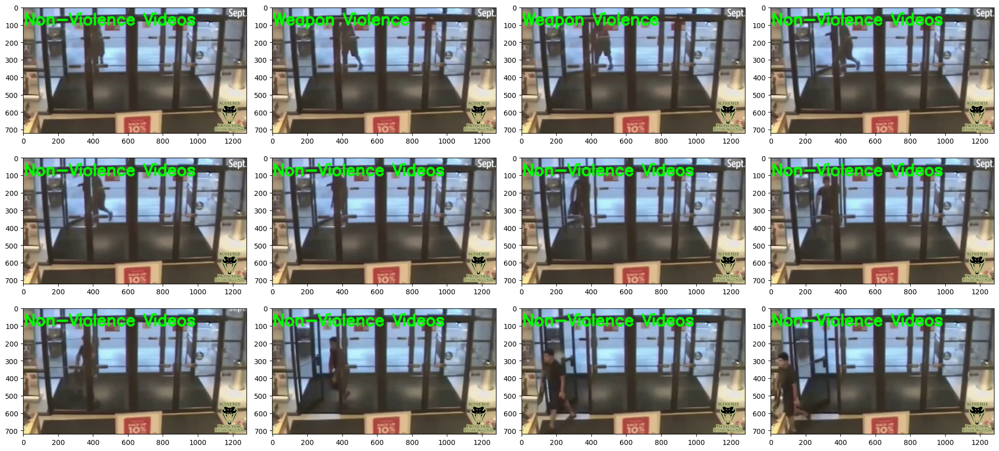

In [86]:
# Specifying video to be predicted
input_video_file_path = "/content/SCVD/videos/Weapon Violence/WV100.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

1/1 [==============================] - 0s 99ms/step


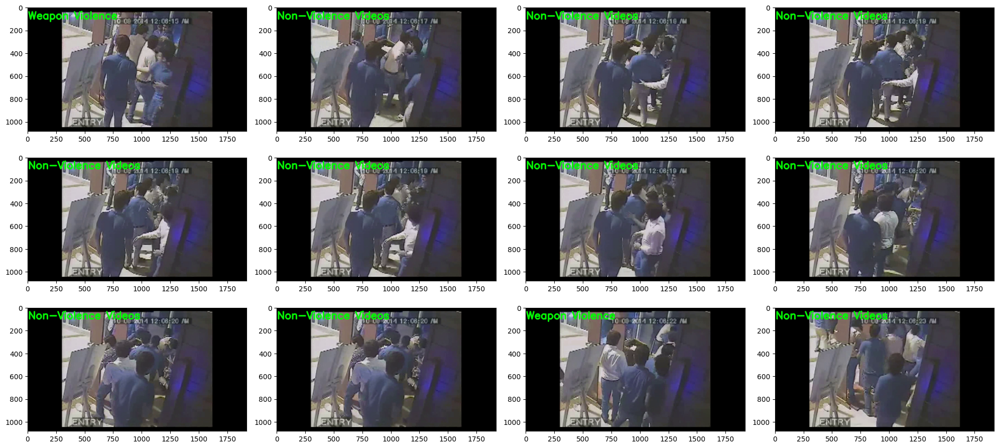

In [87]:
# Specifying video to be predicted
input_video_file_path = "/content/SCVD/videos/violence video cleaned/V109.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

1/1 [==============================] - 0s 87ms/step


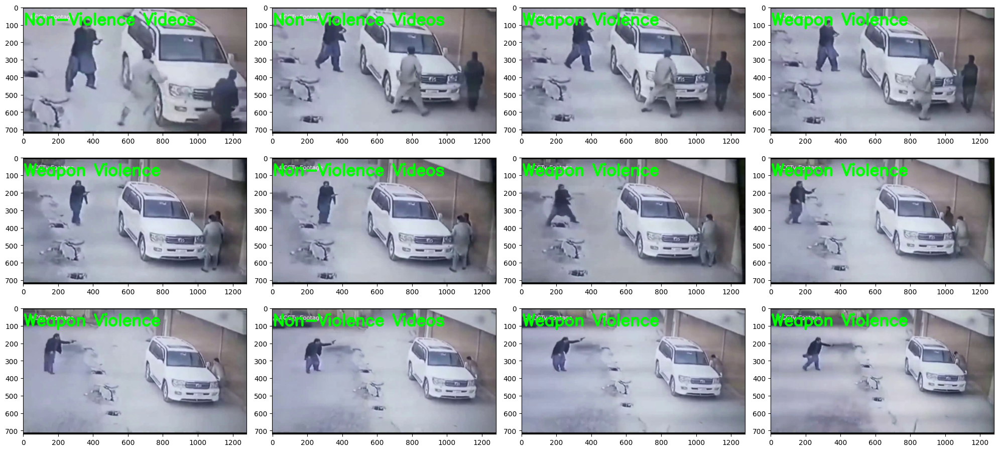

In [89]:
# Specifying video to be predicted
input_video_file_path = "/content/WV4.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

1/1 [==============================] - 0s 74ms/step


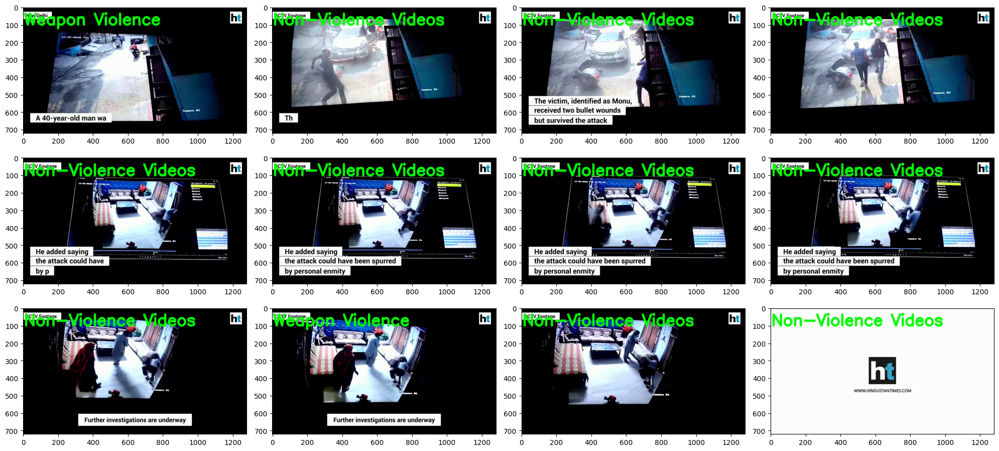

In [92]:
# Specifying video to be predicted
input_video_file_path = "/content/videoplayback (2).mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)